In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import harmonypy as hm
import anndata
import os
import sys
from matplotlib import pyplot as plt
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')


In [2]:
os.chdir('/home/groups/singlecell/smorabito/analysis/SERPENTINE/')
data_dir = '/home/groups/singlecell/smorabito/analysis/SERPENTINE/data/'
fig_dir = '/home/groups/singlecell/smorabito/analysis/SERPENTINE/figures/'


In [3]:
# re-load the processed dataset 
adata = sc.read_h5ad('{}SERPENTINE_PCA_annotated_14-05-24.h5ad'.format(data_dir))
obs = adata.obs
del adata

In [4]:
# re-load the unprocessed data
adata_unp = sc.read('{}SERPENTINE_merged_unprocessed_090424.h5ad'.format(data_dir))

In [5]:
# add the obs table from the processed to the unprocessed
adata_unp = adata_unp[obs.index].copy()
adata_unp.obs = obs

### How many tumor cells get removed if we perform stricter QC?

In [56]:
adata_unp.shape

(242485, 36601)

In [57]:
adata = adata_unp 

In [58]:
cell_counts = adata.obs.general_annot.value_counts()
cell_counts

general_annot
T cells         123546
Tumor            62535
Myeloid          28437
Non-immune        7977
B cells           7816
LQ                7374
Plasma cells      4800
Name: count, dtype: int64

In [66]:
tumor_counts = adata.obs[adata.obs.general_annot  == 'Tumor'].Replicate.value_counts()
tumor_counts

Replicate
SPE_1_09_C2_A_FRESH_CD45neg     6709
SPE_1_07_C2_A_FRESH_1           3741
SPE_1_07_C2_A_FRESH_2           3641
SPE_1_8_C2_A_FRESH_1            3329
SPE_1_08_SCR_A_FRESH            3324
SPE_1_8_C2_A_FRESH_2            3276
SPE_1_09_SCR_A_FRESH            2817
SPE_1_07_EOT_A_FRESH_1          2760
SPE_1_10_C2_A_FRESH_CD45neg     2358
SPE_1_07_EOT_A_FRESH_2          2320
SPE_1_04_SCR_A_FRESH_1          2136
SPE_1_10_SCR_A_FRESH_CD45neg    2053
SPE_1_04_SCR_A_FRESH_2          1956
SPE_1_05_SCR_A_FRESH            1562
SPE_1_04_C02_A_FRESH_1          1127
SPE_1_10_SCR_A_FRESH_CD45pos     999
SPE_1_04_C02_A_FRESH_2           907
SPE_1_02_C02_A_FRESH_1           678
SPE_1_02_SCR_A_FRESH_1           630
SPE_1_02_C02_A_FRESH_2           535
SPE_1_02_SCR_A_FRESH_2           464
SPE_1_09_C2_A_FRESH_CD45pos      172
ESP_1_07_SCR_A_FRESH_CD45neg     129
SPE_1_15_SCR_A_FRESH_2            71
SPE_1_15_SCR_A_FRESH_1            67
SPE_1_14_SCR_A_FRESH_CD45neg      55
ESP_1_03_EOT_A_FRESH_CD45neg

In [60]:
adata.obs['barcode'] = adata.obs.index

In [61]:
# remove by quantiles 

mt_quantile = 0.975
umi_quantile = 0.975
doublet_quantile = 0.975

samples = adata.obs.Replicate.unique().to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Replicate == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_score.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_score < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    


/scratch_tmp/23219170/ipykernel_161625/1826754495.py:7: FutureWarning: Categorical.to_list is deprecated and will be removed in a future version. Use obj.tolist() instead
  samples = adata.obs.Replicate.unique().to_list()


SPE_1_01_SCR_A_FRESH removed  54 , kept  640
SPE_1_01_SCR_A_FRESH_CD45 removed  359 , kept  4319
SPE_1_02_SCR_A_FRESH_1 removed  616 , kept  7605
SPE_1_02_SCR_A_FRESH_2 removed  524 , kept  6277
SPE_1_01_C2D1_A_FRESH_1 removed  355 , kept  4112
SPE_1_01_C2D1_A_FRESH_2 removed  314 , kept  3693
SPE_1_02_C02_A_FRESH_1 removed  511 , kept  6129
SPE_1_03_SCR_A_FRESH removed  87 , kept  1018
SPE_1_02_C02_A_FRESH_2 removed  443 , kept  5325
SPE_1_04_SCR_A_FRESH_2 removed  806 , kept  10319
SPE_1_04_SCR_A_FRESH_1 removed  851 , kept  10697
SPE_1_03_C02_A_FRESH_C45 removed  296 , kept  3511
SPE_1_04_C02_A_FRESH_1 removed  496 , kept  5967
SPE_1_04_C02_A_FRESH_2 removed  413 , kept  5005
ESP_1_03_EOT_A_FRESH_CD45neg removed  29 , kept  218
ESP_1_03_EOT_A_FRESH_CD45pos removed  607 , kept  7698
SPE_1_05_SCR_A_FRESH removed  412 , kept  4983
SPE_1_06_SCR_A_FRESH_CD45neg removed  91 , kept  949
SPE_1_06_SCR_A_FRESH_CD45pos removed  263 , kept  3183
SPE_1_08_SCR_A_FRESH removed  1079 , kept  13567


In [62]:
# subset the full data by the good barcodes
#adata = adata[adata.obs.index.isin(good_barcodes)]
adata.shape

(242485, 36601)

In [63]:
# get rid of more outliers:
adata = adata[adata.obs.total_counts >= 500]
adata = adata[adata.obs.pct_counts_mt <= 10]
adata.shape

(215889, 36601)

In [64]:
postqc_counts = adata.obs.general_annot.value_counts()
postqc_tumor_counts = adata.obs[adata.obs.general_annot  == 'Tumor'].Replicate.value_counts()

In [51]:
# percentage of cells in each compartment that are removed by this QC
(cell_counts - postqc_counts) / cell_counts * 100

general_annot
B cells          2.392528
LQ              99.769460
Myeloid          3.548194
Non-immune       8.649868
Plasma cells     2.729167
T cells          2.041345
Tumor           23.506836
Name: count, dtype: float64

In [65]:
# percentage of cells in each compartment that are removed by this QC
(tumor_counts - postqc_tumor_counts) / tumor_counts * 100

Replicate
ESP_1_03_EOT_A_FRESH_CD45neg     11.111111
ESP_1_03_EOT_A_FRESH_CD45pos     50.000000
ESP_1_07_SCR_A_FRESH_CD45neg      9.154930
ESP_1_07_SCR_A_FRESH_CD45pos           NaN
SPE_1_01_C2D1_A_FRESH_1         100.000000
SPE_1_01_C2D1_A_FRESH_2          80.000000
SPE_1_01_SCR_A_FRESH             45.454545
SPE_1_01_SCR_A_FRESH_CD45              NaN
SPE_1_02_C02_A_FRESH_1           46.104928
SPE_1_02_C02_A_FRESH_2           44.845361
SPE_1_02_SCR_A_FRESH_1           56.730769
SPE_1_02_SCR_A_FRESH_2           55.935423
SPE_1_03_C02_A_FRESH_C45               NaN
SPE_1_03_SCR_A_FRESH                   NaN
SPE_1_04_C02_A_FRESH_1           20.070922
SPE_1_04_C02_A_FRESH_2           19.306050
SPE_1_04_SCR_A_FRESH_1           22.185792
SPE_1_04_SCR_A_FRESH_2           21.445783
SPE_1_05_SCR_A_FRESH             38.065028
SPE_1_06_SCR_A_FRESH_CD45neg           NaN
SPE_1_06_SCR_A_FRESH_CD45pos           NaN
SPE_1_07_C2_A_FRESH_1             3.358305
SPE_1_07_C2_A_FRESH_2             4.032683
S

### Clustering the T cell compartment

In [7]:
adata = adata_unp[adata_unp.obs.general_annot == 'T cells'].copy()

In [8]:
# remove lowly expressed genes:
sc.pp.filter_genes(adata, min_cells=3)

In [9]:
adata.shape

(123546, 29147)

In [10]:
adata.layers['counts'] = adata.X.copy()

In [11]:
# normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# retain the "Raw" adata object for later
# adata.raw = adata

In [ ]:
adata.var.head()

In [10]:
# identify HVGs
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000
)

In [11]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')

In [25]:
sc.external.pp.harmony_integrate(adata, key = ['Subproject_CNAG_x'])

2024-05-16 16:19:19,117 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-16 16:19:31,837 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-16 16:19:33,088 - harmonypy - INFO - Iteration 1 of 10
2024-05-16 16:20:30,786 - harmonypy - INFO - Iteration 2 of 10
2024-05-16 16:21:27,172 - harmonypy - INFO - Iteration 3 of 10
2024-05-16 16:22:22,877 - harmonypy - INFO - Converged after 3 iterations


In [26]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')


/home/groups/singlecell/smorabito/.conda/envs/serp-scanpy/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [27]:
sc.tl.umap(adata, min_dist=0.35, method='umap')

In [28]:
# clustering 
for res in [0.5, 1.0, 1.5, 2.0]:
    print(res)
    x = 'Tcell_leiden_' + str(res)
    sc.tl.leiden(adata, resolution=res)
    adata.obs[x] = adata.obs.leiden
    


# sc.tl.leiden(adata, resolution=1)
# adata.obs['leiden_1.0'] = adata.obs.leiden
# sc.tl.leiden(adata, resolution=2)
# adata.obs['leiden_2.0']


0.5


/scratch_tmp/23200337/ipykernel_192427/2897420522.py:5: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=res)


1.0
1.5
2.0


In [52]:
#sc.tl.dendrogram(adata, 'leiden_2.0')

In [17]:
# save the results
#adata.write('{}SERPENTINE_PCA_14-05-24.h5ad'.format(data_dir))

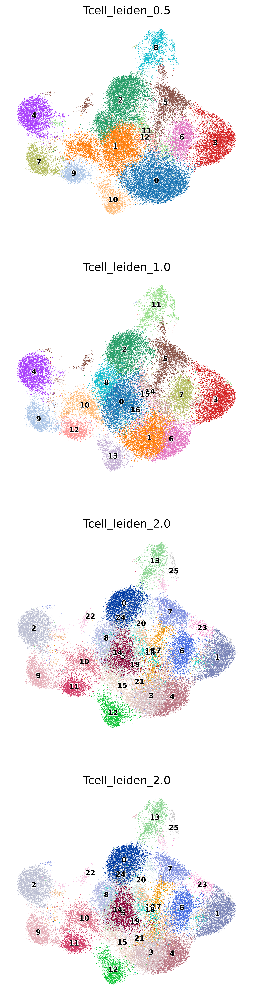

In [31]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['Tcell_leiden_0.5', 'Tcell_leiden_1.0', 'Tcell_leiden_2.0', 'Tcell_leiden_2.0'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=1,
    save='_leiden_tcell.pdf'
)

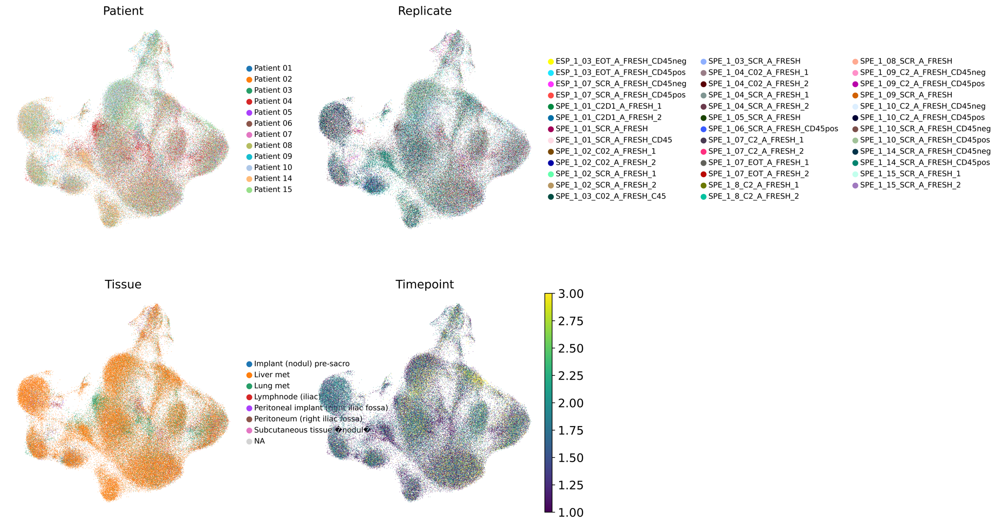

In [30]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['Patient', 'Replicate', 'Tissue', 'Timepoint'],
    frameon=False, 
    #legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=2,
    #title='',
    save='_patients_tcell.pdf'
)

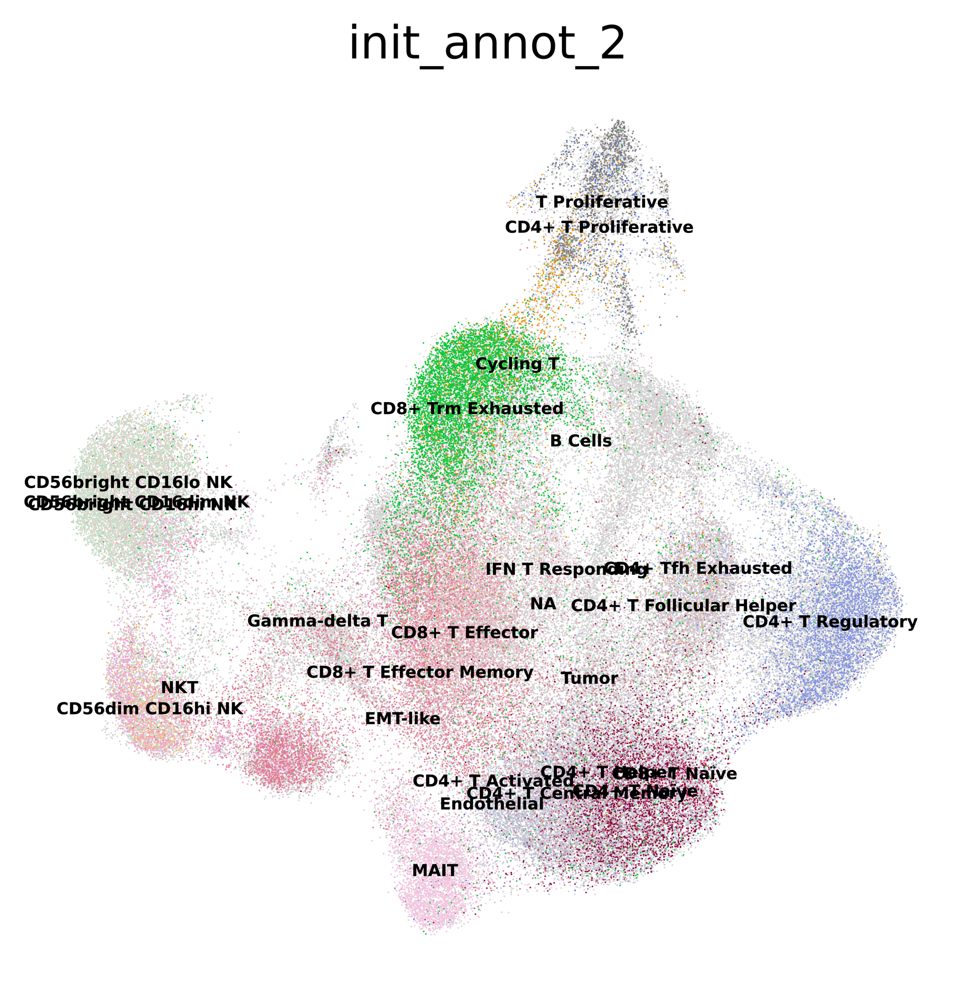

In [38]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['init_annot_2'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=0, 
    legend_fontsize=5, 
    ncols=2,
    #title='',
    #save='_patients_tcell.pdf'
)

In [45]:
import seaborn as sns

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11],
 [Text(0, 0, 'Patient 01'),
  Text(1, 0, 'Patient 02'),
  Text(2, 0, 'Patient 03'),
  Text(3, 0, 'Patient 04'),
  Text(4, 0, 'Patient 05'),
  Text(5, 0, 'Patient 06'),
  Text(6, 0, 'Patient 07'),
  Text(7, 0, 'Patient 08'),
  Text(8, 0, 'Patient 09'),
  Text(9, 0, 'Patient 10'),
  Text(10, 0, 'Patient 14'),
  Text(11, 0, 'Patient 15')])

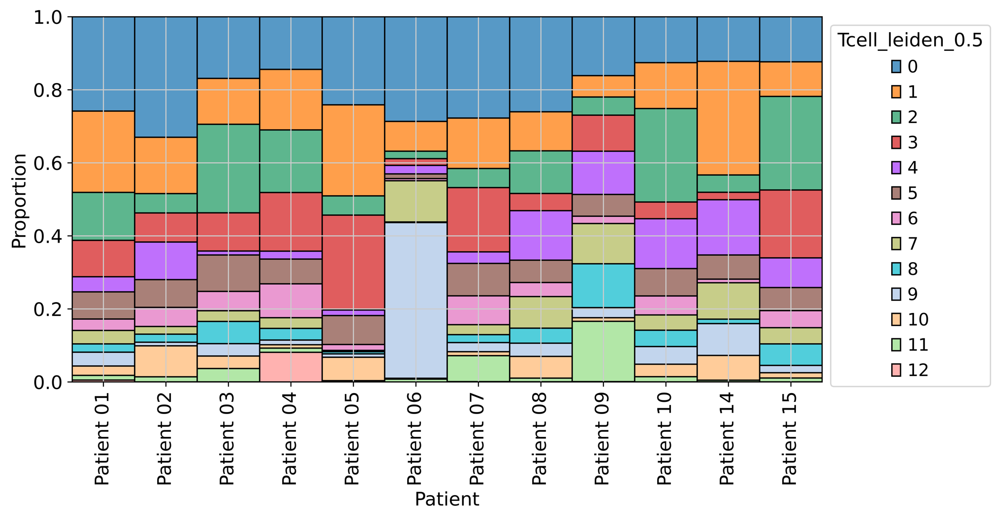

In [49]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(10,5), facecolor='white')
ax = sns.histplot(
    data = adata.obs,
    x = 'Patient',
    hue = 'Tcell_leiden_0.5',
    multiple='fill', stat='proportion',
    discrete=True
)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.xticks(rotation=90)

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38],
 [Text(0, 0, 'ESP_1_03_EOT_A_FRESH_CD45neg'),
  Text(1, 0, 'ESP_1_03_EOT_A_FRESH_CD45pos'),
  Text(2, 0, 'ESP_1_07_SCR_A_FRESH_CD45neg'),
  Text(3, 0, 'ESP_1_07_SCR_A_FRESH_CD45pos'),
  Text(4, 0, 'SPE_1_01_C2D1_A_FRESH_1'),
  Text(5, 0, 'SPE_1_01_C2D1_A_FRESH_2'),
  Text(6, 0, 'SPE_1_01_SCR_A_FRESH'),
  Text(7, 0, 'SPE_1_01_SCR_A_FRESH_CD45'),
  Text(8, 0, 'SPE_1_02_C02_A_FRESH_1'),
  Text(9, 0, 'SPE_1_02_C02_A_FRESH_2'),
  Text(10, 0, 'SPE_1_02_SCR_A_FRESH_1'),
  Text(11, 0, 'SPE_1_02_SCR_A_FRESH_2'),
  Text(12, 0, 'SPE_1_03_C02_A_FRESH_C45'),
  Text(13, 0, 'SPE_1_03_SCR_A_FRESH'),
  Text(14, 0, 'SPE_1_04_C02_A_FRESH_1'),
  Text(15, 0, 'SPE_1_04_C02_A_FRESH_2'),
  Text(16, 0, 'SPE_1_04_SCR_A_FRESH_1'),
  Text(17, 0, 'SPE_1_04_SCR_A_FRESH_2'),
  Text(18, 0, 'SPE_1

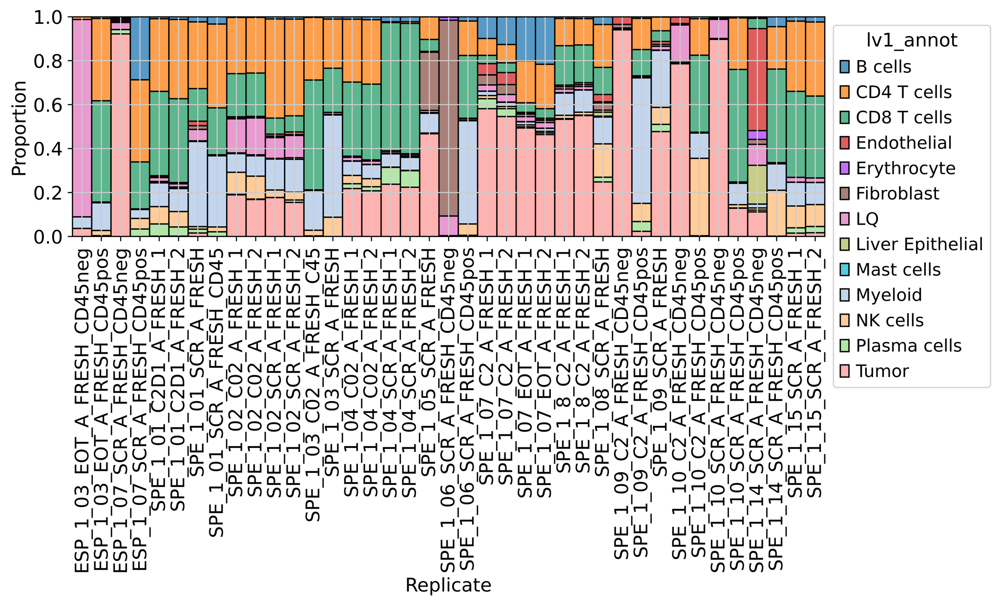

In [112]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(10,3), facecolor='white')
ax = sns.histplot(
    data = adata.obs,
    hue = 'lv1_annot',
    x = 'Replicate',
    multiple='fill', stat='proportion',
    discrete=True
)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.xticks(rotation=90)

In [51]:
# save the results
adata.write('{}SERPENTINE_PCA_annotated_14-05-24.h5ad'.format(data_dir))

## Add previous annotations from Gerard

In [39]:
anno_df = pd.read_table('{}/SP_annotations.csv'.format(data_dir), sep=',')
anno_df = anno_df.rename({'Unnamed: 0': 'barcode'}, axis=1)

anno_df['bc'] = [x.split('_')[-1] for x in anno_df.barcode.to_list()]
anno_df['bc_sample'] = anno_df['sample'].astype(str) + '-' + anno_df.bc.astype(str)

anno_df.head()

,barcode,sample,Annotation_1.0,Annotation_2.0,bc,bc_sample
0,SERPENTINE_04_05_01_CD45_AAACCTGAGCTCAACT,SPE_1_01_SCR_A_FRESH_CD45,Myeloid,cDC2,AAACCTGAGCTCAACT,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGCTCAACT
1,SERPENTINE_04_05_01_CD45_AAACCTGAGTGGGATC,SPE_1_01_SCR_A_FRESH_CD45,Myeloid,CD14+ CD16- Mono,AAACCTGAGTGGGATC,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGTGGGATC
2,SERPENTINE_04_05_01_CD45_AAACCTGAGTTAAGTG,SPE_1_01_SCR_A_FRESH_CD45,CD8 T,CD8+ Trm Exhausted,AAACCTGAGTTAAGTG,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGAGTTAAGTG
3,SERPENTINE_04_05_01_CD45_AAACCTGTCCGCAGTG,SPE_1_01_SCR_A_FRESH_CD45,CD8 T,T Proliferative,AAACCTGTCCGCAGTG,SPE_1_01_SCR_A_FRESH_CD45-AAACCTGTCCGCAGTG
4,SERPENTINE_04_05_01_CD45_AAACGGGAGCGTTTAC,SPE_1_01_SCR_A_FRESH_CD45,CD4 T,CD4+ T Helper,AAACGGGAGCGTTTAC,SPE_1_01_SCR_A_FRESH_CD45-AAACGGGAGCGTTTAC


In [41]:
adata.obs['bc_sample'] = adata.obs.Replicate.astype(str) + '-' + adata.obs.bc.astype(str)

In [43]:

# merge with anndata obs
temp = adata.obs.merge(anno_df, how='left', on = 'bc_sample')
#temp.index = temp.barcode
#adata.obs = temp

temp.head()

adata.obs['init_annot_1'] = temp['Annotation_1.0'].to_list()
adata.obs['init_annot_2'] = temp['Annotation_2.0'].to_list()


#adata.obs['general_annot'] = temp.general_annot.to_list()
#adata.obs['lv1_annot'] = temp.lv1_annot.to_list()

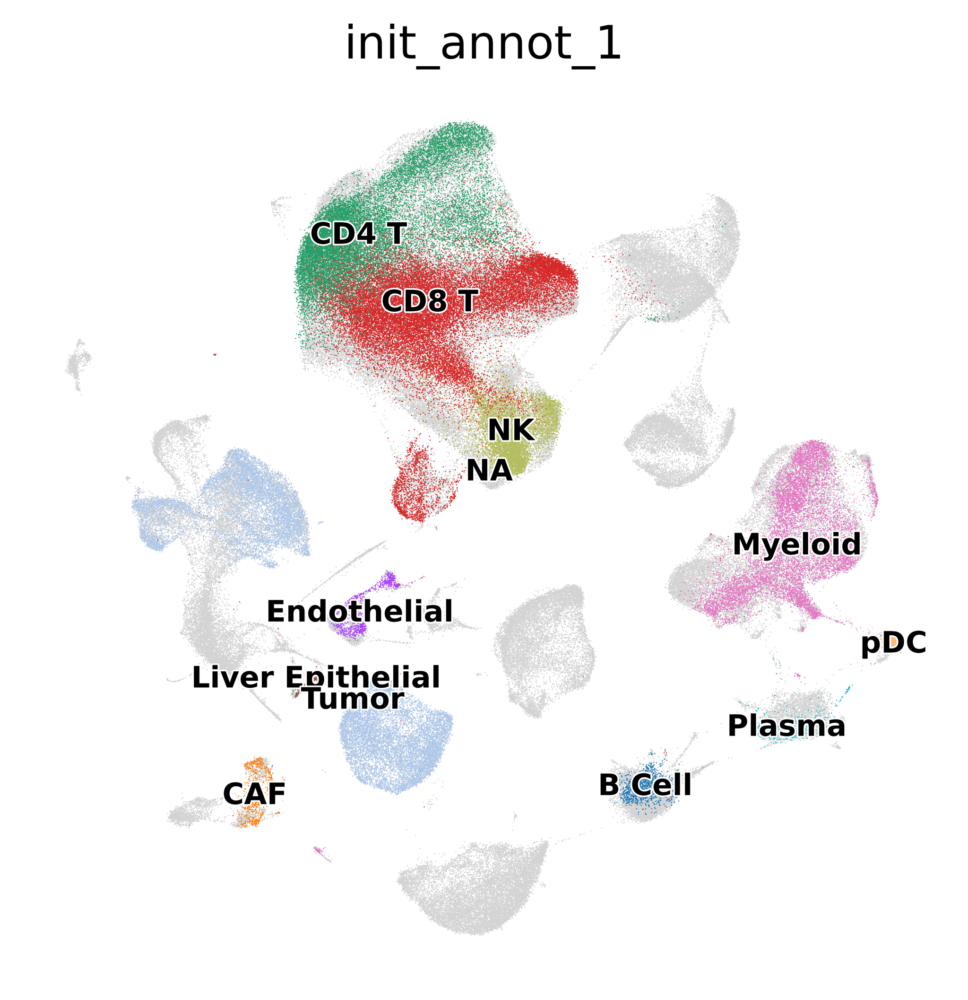

In [46]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['init_annot_1'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=1,
    save='_annot1_previous.pdf'
)

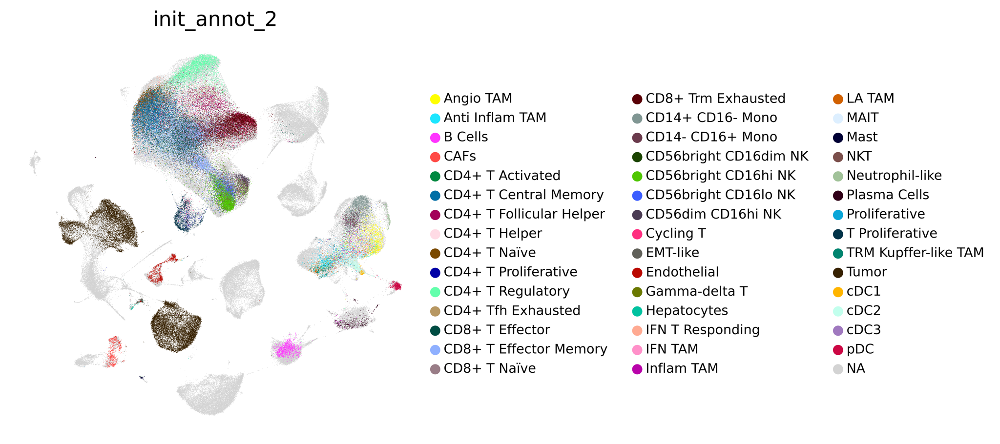

In [47]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['init_annot_2'],
    frameon=False, 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    ncols=1,
    save='_annot2_previous.pdf'
)

In [48]:
adata.write('{}SERPENTINE_PCA_annotated_14-05-24.h5ad'.format(data_dir))

## Look at genes suggested by AZ collaborators

Look only in the Endometrial Cancer (EC) patients

* Please include expression levels of each gene, separately of the other 3 genes, per sample.
* Please have a joint plot for all 4 genes in different combinations, per sample.
* Please highlight expression in tumor vs normal epithelial cells, if possible.
* Please indicate gene expression per endometrial cancer subtypes ( POLE ultramutated, microsatellite instability hypermutated, copy number low, and copy number high).
* Please see if these any correlation of tumor cells and any specific type of immune cell.

This kind of correlation is not possible given the sample size. We have 15 reps, 4 patients. I can try but who knows. I still dont' know what they are talking about for the second point. We don't really have normal epithelial cells. We have some of these endometrial subtypes.


In [8]:
import seaborn as sns

In [52]:
adata = sc.read('{}SERPENTINE_PCA_annotated_14-05-24.h5ad'.format(data_dir))

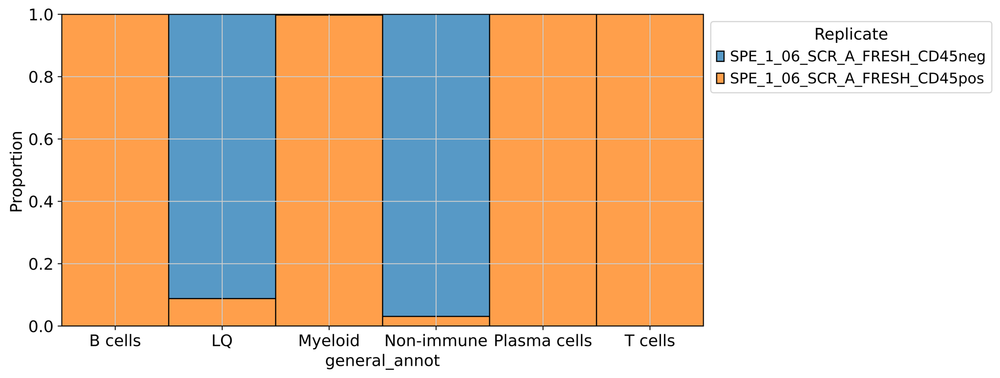

In [73]:
# what's up with patient 6? where are the tumor cells?
pt6 = adata[adata.obs.Patient == 'Patient 06'].copy()
pt6.shape

sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(10,5), facecolor='white')
ax = sns.histplot(
    data = pt6.obs,
    x = 'general_annot',
    hue = 'Replicate',
    multiple='fill', stat='proportion',
    discrete=True
)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [23]:
# subset the tumor cells only:
adata_tumor = adata[adata.obs.general_annot == 'Tumor'].copy()

# subset the cells from endometrial cancer patients
adata_tumor = adata_tumor[adata_tumor.obs['Tumor Type'] == 'Endometrial'].copy()

adata_tumor.shape

(43098, 36601)

In [24]:
len(adata_tumor.obs.Replicate.unique())

15

In [25]:
adata_tumor.obs.Patient.unique()

['Patient 04', 'Patient 08', 'Patient 09', 'Patient 07']
Categories (4, object): ['Patient 04', 'Patient 07', 'Patient 08', 'Patient 09']

In [26]:
gene_list = [
    'ERBB2', # HER2
    'TACSTD2', # TROP2
    'VTCN1', # B7H4
    'FOLR1'
]

# compute a gene score for these 4 genes combined:
sc.tl.score_genes(adata_tumor, gene_list = gene_list, score_name = 'combined')
#gene_list.append('combined')

In [27]:
gene_list

['ERBB2', 'TACSTD2', 'VTCN1', 'FOLR1']

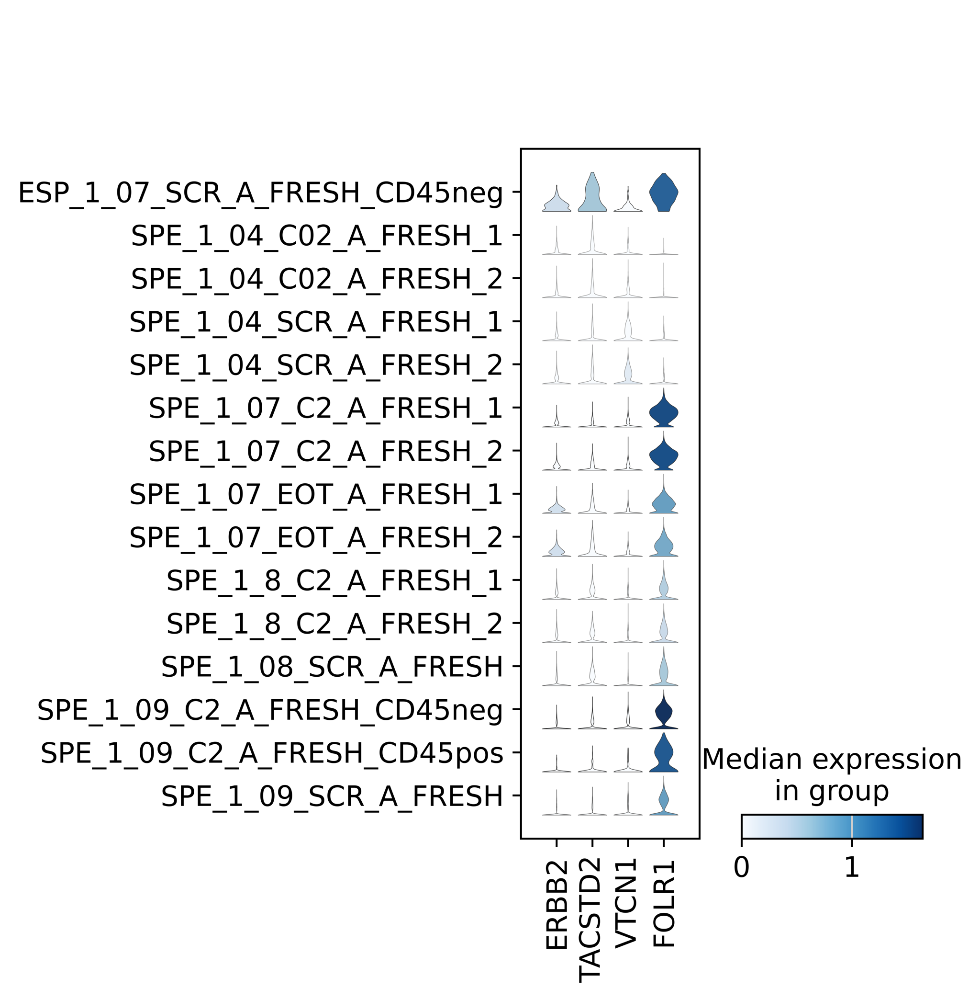

In [29]:
sc.settings.set_figure_params(dpi=400, dpi_save=400, figsize=(10,3), facecolor='white')
sc.pl.stacked_violin(
    adata_tumor, gene_list, 
    groupby='Replicate',
    save = 'stacked_violin_Replicates.pdf'
)




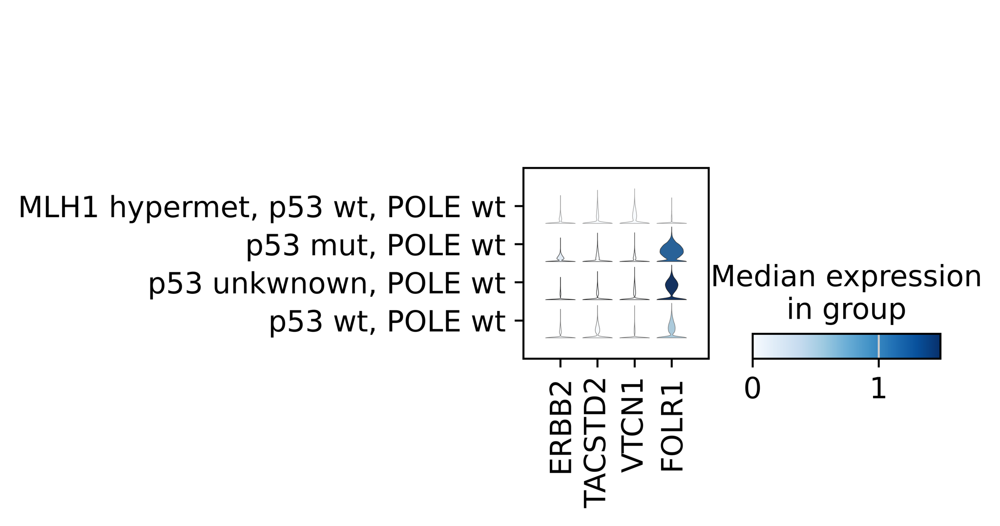

In [30]:
sc.settings.set_figure_params(dpi=400, dpi_save=400, figsize=(10,3), facecolor='white')
sc.pl.stacked_violin(
    adata_tumor, gene_list, 
    groupby='Molecular profile',
    save = 'stacked_violin_molecular_profile.pdf'
)


In [101]:
adata_tumor.obs['Molecular profile'].unique()

['MLH1 hypermet, p53 wt, POLE wt', 'p53 wt, POLE wt', 'p53 unkwnown, POLE wt', 'p53 mut, POLE wt']
Categories (4, object): ['MLH1 hypermet, p53 wt, POLE wt', 'p53 mut, POLE wt', 'p53 unkwnown, POLE wt', 'p53 wt, POLE wt']

In [70]:
adata_tumor.obs.head()

,Subproject_CNAG_x,Replicate,Patient,bc,batch,DOB,Tumor Type,Primary tumor,Histology,Microsatellite status,...,pct_counts_mt,doublet_score,predicted_doublet,leiden,leiden_0.5,leiden_1.0,leiden_1.5,leiden_2.0,general_annot,lv1_annot
barcode,,,,,,,,,,,,,,,,,,,,,
ACACTGATCGATCCCT-1-0,SERPENTINE_04_05,SPE_1_01_SCR_A_FRESH,Patient 01,ACACTGATCGATCCCT,0,15APR71,CRC,Rectum,Adenocarcinoma,MSS,...,18.413704,0.212500,False,23,8,5,4,23,Tumor,Tumor
ATCATCTGTCTGGTCG-1-0,SERPENTINE_04_05,SPE_1_01_SCR_A_FRESH,Patient 01,ATCATCTGTCTGGTCG,0,15APR71,CRC,Rectum,Adenocarcinoma,MSS,...,29.486427,0.186441,False,18,8,5,4,18,Tumor,Tumor
CGATGTATCATTGCCC-1-0,SERPENTINE_04_05,SPE_1_01_SCR_A_FRESH,Patient 01,CGATGTATCATTGCCC,0,15APR71,CRC,Rectum,Adenocarcinoma,MSS,...,0.000000,0.118367,False,23,8,5,4,23,Tumor,Tumor
CGGCTAGAGGACACCA-1-0,SERPENTINE_04_05,SPE_1_01_SCR_A_FRESH,Patient 01,CGGCTAGAGGACACCA,0,15APR71,CRC,Rectum,Adenocarcinoma,MSS,...,6.343337,0.186441,False,23,8,5,4,23,Tumor,Tumor
CTTACCGTCGATAGAA-1-0,SERPENTINE_04_05,SPE_1_01_SCR_A_FRESH,Patient 01,CTTACCGTCGATAGAA,0,15APR71,CRC,Rectum,Adenocarcinoma,MSS,...,51.293396,0.028000,False,18,8,5,4,18,Tumor,Tumor


In [71]:
adata_tumor.obs.columns

Index(['Subproject_CNAG_x', 'Replicate', 'Patient', 'bc', 'batch', 'DOB',
       'Tumor Type', 'Primary tumor', 'Histology', 'Microsatellite status',
       'Molecular profile', 'N pre lines', 'Previous therapies',
       'Metastases location', 'Cohort', 'Treatment', 'Biopsy pre-treat',
       'Biopsy pre-C2', 'Biopsy', 'BiopsyEOT', 'Best response',
       'Subproject_CNAG_y', 'ID_CNAG', 'Tissue', 'Libraries', 'Sample',
       'Timepoint', 'Info', 'Fractions loaded', 'biopsy_id',
       'localizacion_SNOMED', 'Timepoint_1', 'n_genes_by_counts',
       'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score',
       'predicted_doublet', 'leiden', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5',
       'leiden_2.0', 'general_annot', 'lv1_annot'],
      dtype='object')

### Compute pairwise correlations of cell counts

Yeah I don't want to send this to the collaborators, this doesn't make sense. We mostly see Tumor cells in the CD45- fraction, in which case we know it's not immune cells. Maybe we can just take the "FRESH" samples rather than the sorted and then it makes more sense?

In [9]:
# which replicates have tumor cells?
tumor_reps = adata.obs[adata.obs.general_annot == 'Tumor'].Replicate.astype(str).unique()
ix = [True if "CD45" not in x else False for x in tumor_reps]
tumor_reps = tumor_reps[ix]

In [10]:
# get endometrial patients 
cur_adata = adata[adata.obs['Tumor Type'] == 'Endometrial'].copy()
cur_adata = cur_adata[cur_adata.obs.Replicate.isin(tumor_reps)].copy()
cur_adata = cur_adata[cur_adata.obs.general_annot != 'LQ'].copy()
cur_adata.shape

(93326, 36601)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11],
 [Text(0, 0, 'SPE_1_04_C02_A_FRESH_1'),
  Text(1, 0, 'SPE_1_04_C02_A_FRESH_2'),
  Text(2, 0, 'SPE_1_04_SCR_A_FRESH_1'),
  Text(3, 0, 'SPE_1_04_SCR_A_FRESH_2'),
  Text(4, 0, 'SPE_1_07_C2_A_FRESH_1'),
  Text(5, 0, 'SPE_1_07_C2_A_FRESH_2'),
  Text(6, 0, 'SPE_1_07_EOT_A_FRESH_1'),
  Text(7, 0, 'SPE_1_07_EOT_A_FRESH_2'),
  Text(8, 0, 'SPE_1_8_C2_A_FRESH_1'),
  Text(9, 0, 'SPE_1_8_C2_A_FRESH_2'),
  Text(10, 0, 'SPE_1_08_SCR_A_FRESH'),
  Text(11, 0, 'SPE_1_09_SCR_A_FRESH')])

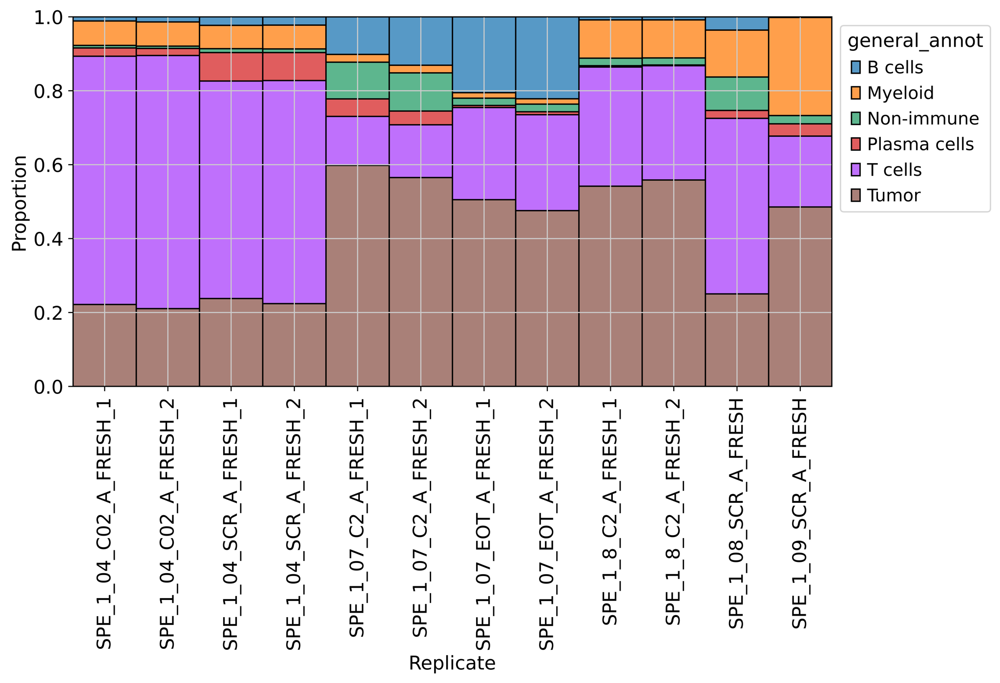

In [11]:
sc.settings.set_figure_params(dpi=400, dpi_save=500, figsize=(10,5), facecolor='white')
ax = sns.histplot(
    data = cur_adata.obs,
    hue = 'general_annot',
    x = 'Replicate',
    multiple='fill', stat='proportion',
    discrete=True
)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.xticks(rotation=90)

In [12]:
df = cur_adata.obs.groupby(['Replicate', 'lv1_annot']).size()
df = df.reset_index(level=[0,1])
df = df.rename({0: 'count'}, axis=1)
df = df.pivot(index='Replicate', columns='lv1_annot', values='count')
#df.head()

/scratch_tmp/23047792/ipykernel_70216/3384629151.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = cur_adata.obs.groupby(['Replicate', 'lv1_annot']).size()


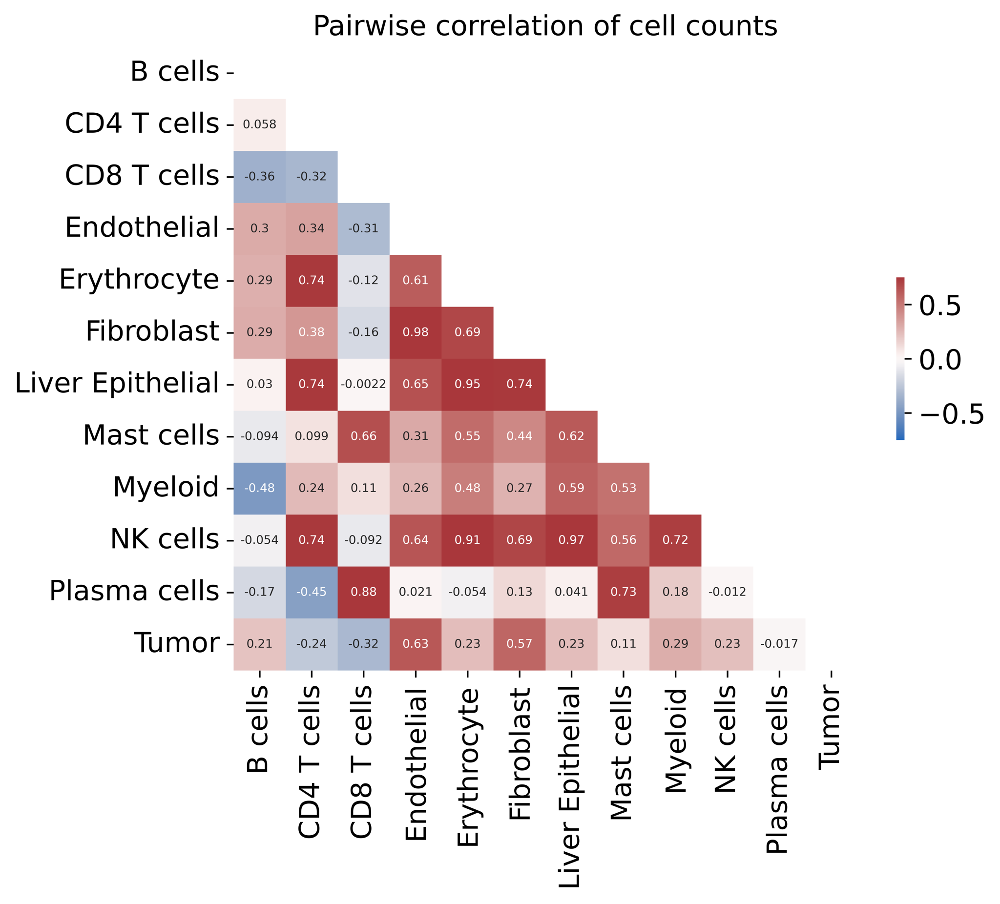

In [21]:

sc.settings.set_figure_params(dpi=400, dpi_save=400, figsize=(7,6), facecolor='white')

corr = df.corr()
matrix = np.triu(corr)

ax = sns.heatmap(
    corr, 
    annot=True, annot_kws={'size':6},
    mask=matrix, 
    square=True, 
    vmax=0.75, vmin=-0.75,
    cmap=sns.color_palette('vlag',as_cmap=True),
    cbar_kws={'shrink': 0.25}
)
ax.grid(False)
ax.set_title('Pairwise correlation of cell counts')
ax.set_ylabel('')
ax.set_xlabel('')
plt.savefig('{}/cell_count_correlations.pdf'.format(fig_dir))